In [1]:
import warnings
warnings.simplefilter('ignore')
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.model_selection import train_test_split  # sklearn.cross_validation in old versions
import re
from time import time
from scipy import stats
import json

import numpy as np
import pandas as pd

# Loading Data

In [2]:
application_test = pd.read_csv('application_test.csv')
application_train = pd.read_csv('application_train.csv')
# bureau = pd.read_csv('bureau.csv')
# bureau_balance = pd.read_csv('bureau_balance.csv')
# credit_card_balance = pd.read_csv('credit_card_balance.csv')
# # HomeCredit_columns_description = pd.read_csv('HomeCredit_columns_description.csv')
# installments_payments = pd.read_csv('installments_payments.csv')
# POS_CASH_balance = pd.read_csv('POS_CASH_balance.csv')
# previous_application = pd.read_csv('previous_application.csv')
# sample_submission = pd.read_csv('sample_submission.csv')

# EDA

In [86]:
def EDA(df,df_name):
    print("Test description; data type: {}".format(df_name))
    print(df.dtypes)
    print("\n##########################################################\n")
    print(" Dataset size (rows columns): {}".format(df_name))
    print(df.shape)
    print("\n##########################################################\n")
    print("Summary statistics: {}".format(df_name))
    print(df.describe())
    print("\n##########################################################\n")
    print("Correlation analysis: {}".format(df_name))
    print(df.corr())
    print("\n##########################################################\n")
    print("Other Analysis: {}".format(df_name))
    print("1. Checking for Null values: {}".format(df_name))
    print(df.isna().sum())
    print("\n2. Info")
    print(df.info())

In [87]:
EDA(application_train,'application_train_data')

Test description; data type: application_train_data
SK_ID_CURR                      int64
TARGET                          int64
NAME_CONTRACT_TYPE             object
CODE_GENDER                    object
FLAG_OWN_CAR                   object
                               ...   
AMT_REQ_CREDIT_BUREAU_DAY     float64
AMT_REQ_CREDIT_BUREAU_WEEK    float64
AMT_REQ_CREDIT_BUREAU_MON     float64
AMT_REQ_CREDIT_BUREAU_QRT     float64
AMT_REQ_CREDIT_BUREAU_YEAR    float64
Length: 122, dtype: object

##########################################################

 Dataset size (rows columns): application_train_data
(307511, 122)

##########################################################

Summary statistics: application_train_data
          SK_ID_CURR         TARGET   CNT_CHILDREN  AMT_INCOME_TOTAL  \
count  307511.000000  307511.000000  307511.000000      3.075110e+05   
mean   278180.518577       0.080729       0.417052      1.687979e+05   
std    102790.175348       0.272419       0.722121     

SK_ID_CURR                        0
TARGET                            0
NAME_CONTRACT_TYPE                0
CODE_GENDER                       0
FLAG_OWN_CAR                      0
                              ...  
AMT_REQ_CREDIT_BUREAU_DAY     41519
AMT_REQ_CREDIT_BUREAU_WEEK    41519
AMT_REQ_CREDIT_BUREAU_MON     41519
AMT_REQ_CREDIT_BUREAU_QRT     41519
AMT_REQ_CREDIT_BUREAU_YEAR    41519
Length: 122, dtype: int64

2. Info
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB
None


<h1> Target Vs borrowers based on gender </h1>

In [30]:
male_data = application_train[application_train['CODE_GENDER']=='M']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
male_data['count_percent'] = male_data['user_count']/male_data['user_count'].sum()*100
male_data['CODE_GENDER'] = 'M'
female_data = application_train[application_train['CODE_GENDER']=='F']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
female_data['count_percent'] = female_data['user_count']/female_data['user_count'].sum()*100
female_data['CODE_GENDER'] = 'F'
gender_data = male_data.append(female_data, ignore_index=True,sort=False)
gender_data

,TARGET,user_count,count_percent,CODE_GENDER
0,0,94404,89.858080,M
1,1,10655,10.141920,M
2,0,188278,93.000672,F
3,1,14170,6.999328,F


Text(10.788472222222218, 0.5, 'User count in Percentage')

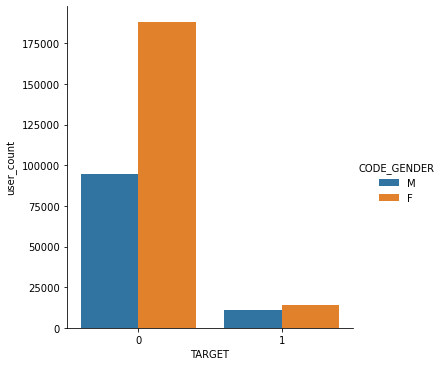

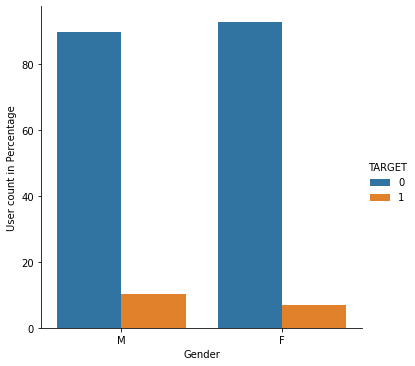

In [41]:
sns.catplot(data=gender_data, kind="bar", x="TARGET", y="user_count", hue="CODE_GENDER")
sns.catplot(data=gender_data, kind="bar", x="CODE_GENDER", y="count_percent", hue="TARGET")
plt.xlabel("Gender")
plt.ylabel('User count in Percentage')

### Male most likely to default than Female based on percentage of defaulter_count(Second Graph)

<h1> Gender Vs Income based on Target </h1>

Text(0, 0.5, 'Annual Income')

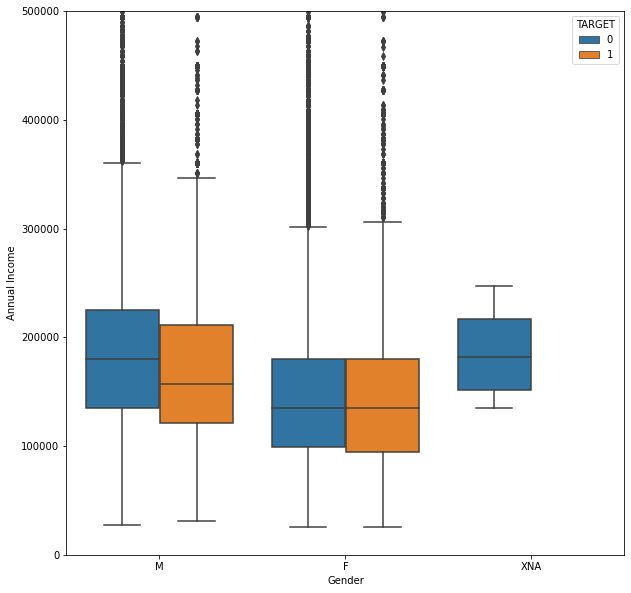

In [8]:
fig,ax = plt.subplots(figsize = (10,10))
sns.boxplot(x='CODE_GENDER',hue = 'TARGET',y='AMT_INCOME_TOTAL', data=application_train)
plt.ylim(0, 500000)
plt.xlabel("Gender")
plt.ylabel('Annual Income')

<h1> Own House count based Target </h1>

In [46]:
own_house_data = application_train[application_train['FLAG_OWN_REALTY']=='Y']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
own_house_data['OWN_HOUSE'] = 'Y'
own_house_data['count_percent'] = own_house_data['user_count']/own_house_data['user_count'].sum()*100
not_own_house_data = application_train[application_train['FLAG_OWN_REALTY']=='N']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
not_own_house_data['OWN_HOUSE'] = 'N'
not_own_house_data['count_percent'] = not_own_house_data['user_count']/not_own_house_data['user_count'].sum()*100
own_house_data = own_house_data.append(not_own_house_data,ignore_index=True,sort=False)
own_house_data

,TARGET,user_count,OWN_HOUSE,count_percent
0,0,196329,Y,92.038423
1,1,16983,Y,7.961577
2,0,86357,N,91.675071
3,1,7842,N,8.324929


Text(10.788472222222218, 0.5, 'User count in Percentage')

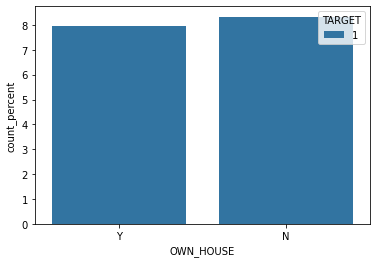

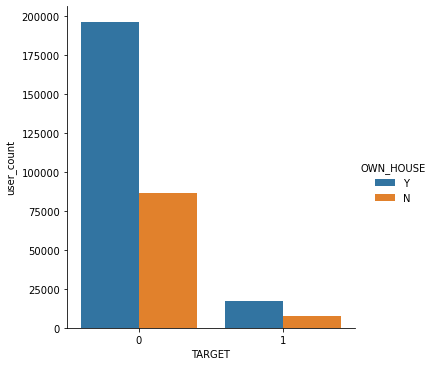

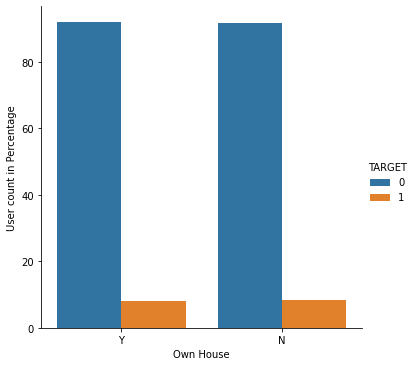

In [100]:
sns.barplot(x='OWN_HOUSE',y='count_percent',hue = 'TARGET',data=own_house_data[own_house_data['TARGET']==1])

sns.catplot(data=own_house_data, kind="bar", x="TARGET", y="user_count", hue="OWN_HOUSE")

sns.catplot(data=own_house_data, kind="bar", x="OWN_HOUSE", y="count_percent", hue="TARGET")
plt.xlabel("Own House")
plt.ylabel('User count in Percentage')

### Not a significant difference, but borrowers who own a house are more likely to pay

<h1> Own car count based Target </h1>

In [88]:
own_car_data = application_train[application_train['FLAG_OWN_CAR']=='Y']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
own_car_data['FLAG_OWN_CAR'] = 'Y'
own_car_data['count_percent'] = own_car_data['user_count']/own_car_data['user_count'].sum()*100
not_own_car_data = application_train[application_train['FLAG_OWN_CAR']=='N']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
not_own_car_data['FLAG_OWN_CAR'] = 'N'
not_own_car_data['count_percent'] = not_own_car_data['user_count']/not_own_car_data['user_count'].sum()*100
own_car_data = own_car_data.append(not_own_car_data,ignore_index=True,sort=False)
own_car_data

,TARGET,user_count,FLAG_OWN_CAR,count_percent
0,0,97011,Y,92.756270
1,1,7576,Y,7.243730
2,0,185675,N,91.499773
3,1,17249,N,8.500227


Text(10.788472222222218, 0.5, 'User count in Percentage')

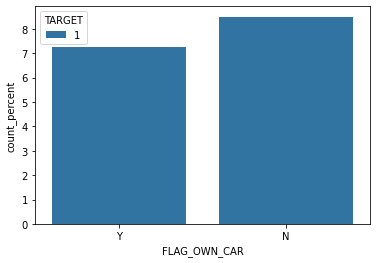

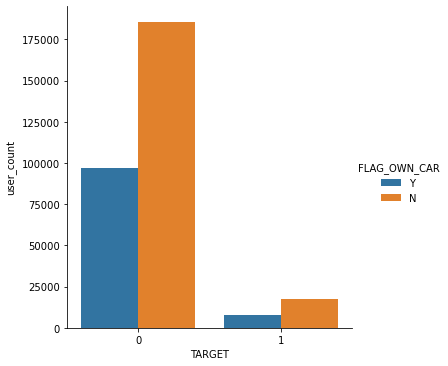

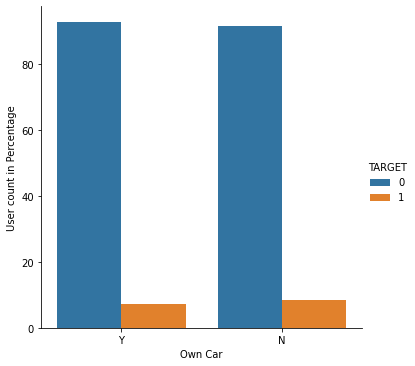

In [99]:
sns.barplot(x='FLAG_OWN_CAR',y='count_percent',hue = 'TARGET',data=own_car_data[own_car_data['TARGET']==1])

sns.catplot(data=own_car_data, kind="bar", x="TARGET", y="user_count", hue="FLAG_OWN_CAR")

sns.catplot(data=own_car_data, kind="bar", x="FLAG_OWN_CAR", y="count_percent", hue="TARGET")
plt.xlabel("Own Car")
plt.ylabel('User count in Percentage')

### Borrowers owning a car are more likely to pay on time

<h1> Occupation type count based on Target </h1>

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17]),
 [Text(0, 0, 'Laborers'),
  Text(1, 0, 'Core staff'),
  Text(2, 0, 'Accountants'),
  Text(3, 0, 'Managers'),
  Text(4, 0, 'Drivers'),
  Text(5, 0, 'Sales staff'),
  Text(6, 0, 'Cleaning staff'),
  Text(7, 0, 'Cooking staff'),
  Text(8, 0, 'Private service staff'),
  Text(9, 0, 'Medicine staff'),
  Text(10, 0, 'Security staff'),
  Text(11, 0, 'High skill tech staff'),
  Text(12, 0, 'Waiters/barmen staff'),
  Text(13, 0, 'Low-skill Laborers'),
  Text(14, 0, 'Realty agents'),
  Text(15, 0, 'Secretaries'),
  Text(16, 0, 'IT staff'),
  Text(17, 0, 'HR staff')])

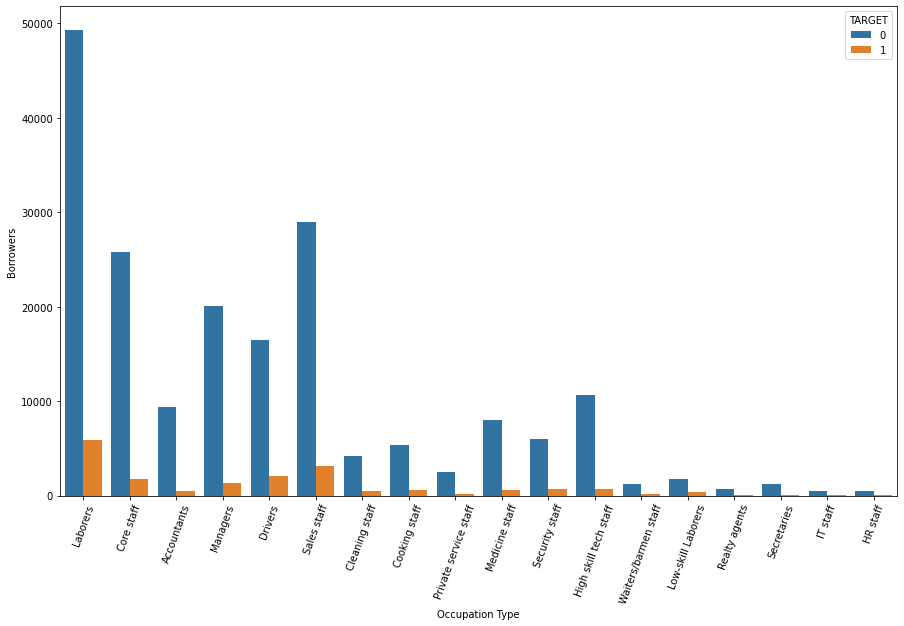

In [11]:
fig, ax = plt.subplots(figsize=(15,9))
sns.countplot(x='OCCUPATION_TYPE', hue = 'TARGET',data=application_train)
plt.xlabel("Occupation Type")
plt.ylabel('Borrowers')
plt.xticks(rotation=70)


<h1> Occupation type vs income based on Target </h1>

Text(0, 0.5, 'Average Annual family income')

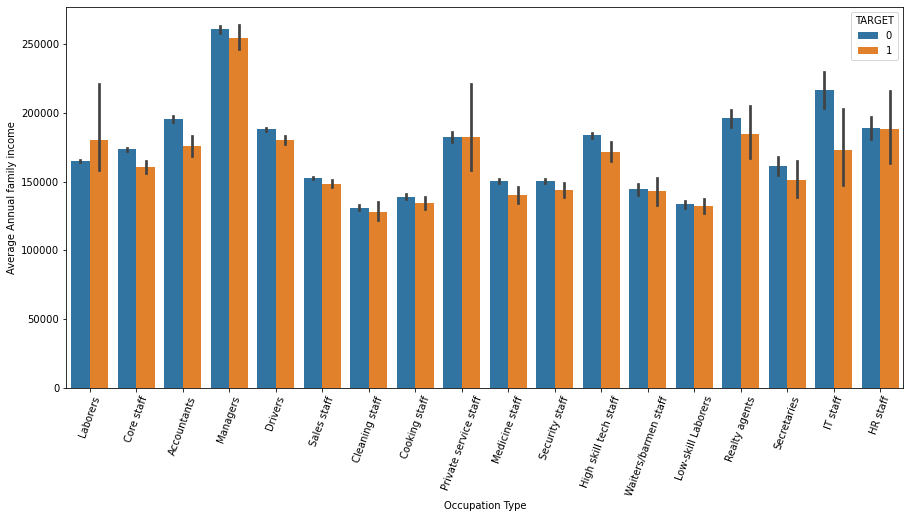

In [12]:
fig, ax = plt.subplots(figsize=(15,7))
sns.barplot(x='OCCUPATION_TYPE',y='AMT_INCOME_TOTAL',hue = 'TARGET',data=application_train)
plt.xticks(rotation=70)
plt.xlabel("Occupation Type")
plt.ylabel("Average Annual family income")

In [76]:
income_credit_ratio_data = application_train[['AMT_INCOME_TOTAL','AMT_CREDIT','TARGET']]
income_credit_ratio_data['IC_ratio'] = income_credit_ratio_data['AMT_INCOME_TOTAL']/income_credit_ratio_data['AMT_CREDIT']
income_credit_ratio_data['quantile'] = pd.qcut(income_credit_ratio_data['IC_ratio'],q = 10, labels = False)
income_credit_ratio_data

,AMT_INCOME_TOTAL,AMT_CREDIT,TARGET,IC_ratio,quantile
0,202500.0,406597.5,1,0.498036,7
1,270000.0,1293502.5,0,0.208736,2
2,67500.0,135000.0,0,0.500000,7
3,135000.0,312682.5,0,0.431748,6
4,121500.0,513000.0,0,0.236842,3
...,...,...,...,...,...
307506,157500.0,254700.0,0,0.618375,8
307507,72000.0,269550.0,0,0.267112,4
307508,153000.0,677664.0,0,0.225776,3
307509,171000.0,370107.0,1,0.462029,7


In [77]:
income_credit_ratio_data = income_credit_ratio_data.groupby(['quantile','TARGET'])['AMT_INCOME_TOTAL'].count().reset_index().rename(columns={'AMT_INCOME_TOTAL':'user_count'})
income_credit_ratio_data['count_percent'] = income_credit_ratio_data.apply(lambda x: x['user_count']/income_credit_ratio_data[income_credit_ratio_data['quantile']==x['quantile']]['user_count'].sum()*100,axis=1)
income_credit_ratio_data

,quantile,TARGET,user_count,count_percent
0,0,0,28613,92.929523
1,0,1,2177,7.070477
2,1,0,28499,92.577313
3,1,1,2285,7.422687
4,2,0,28241,92.035196
5,2,1,2444,7.964804
6,3,0,28128,91.375110
7,3,1,2655,8.624890
8,4,0,27899,90.805234
9,4,1,2825,9.194766


Text(0, 0.5, 'defaulter/Non-defaulter percentage')

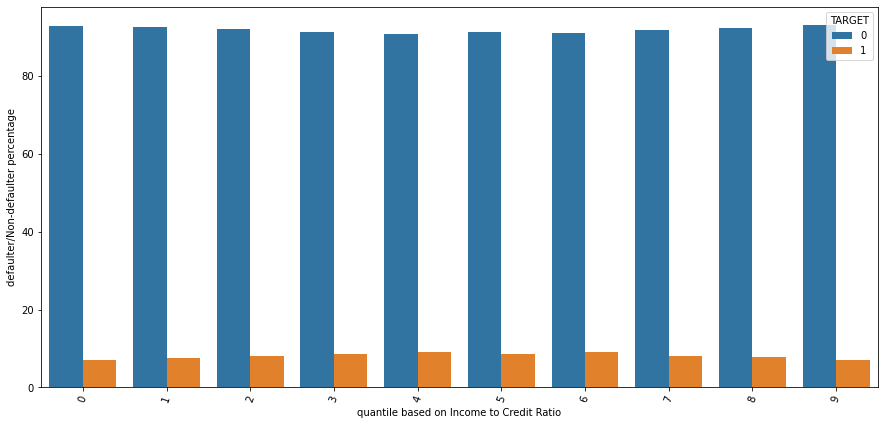

In [72]:
fig, ax = plt.subplots(figsize=(15,7))
sns.barplot(x='quantile',y='count_percent',hue = 'TARGET',data=income_credit_ratio_data)
plt.xticks(rotation=70)
plt.xlabel("quantile based on Income to Credit Ratio")
plt.ylabel("defaulter/Non-defaulter percentage")

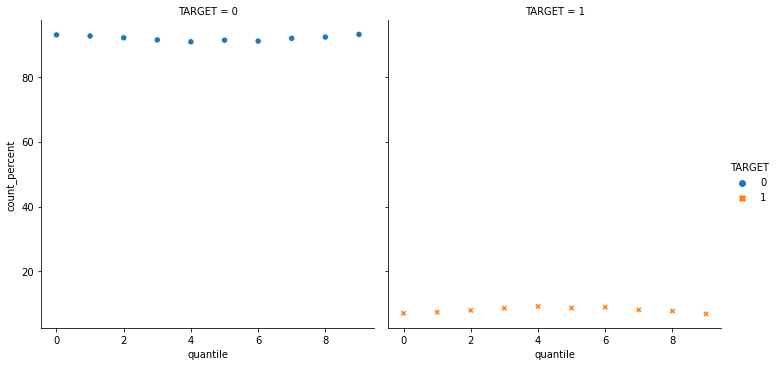

In [84]:
sns.relplot(
    data=income_credit_ratio_data, x="quantile", y="count_percent",
    col="TARGET", hue="TARGET", style="TARGET",
    kind="scatter"
)

### Defaulters percentage is less when IC_ratio is either Low or High

<h1> Repayers to Applicants Ratio </h1>

In [43]:
occ_data = pd.DataFrame(data=application_train.groupby(['OCCUPATION_TYPE','TARGET']).count()['SK_ID_CURR'])
occ_data = occ_data.reset_index() 
value_counts = occ_data['SK_ID_CURR'].values
def repayers_to_applicants_ratio(values):
    flag = 1
    ratios = []
    for count in range(len(values)):
        if flag == 1:
            current_number = values[count]
            next_number = values[count+1]
            ratios.append(current_number/(current_number+next_number))
            ratios.append(current_number/(current_number+next_number))
        flag=flag*-1
    return ratios
occ_data['Ratio R/A'] = repayers_to_applicants_ratio(value_counts)
occ_ratio = occ_data.groupby(['OCCUPATION_TYPE','Ratio R/A']).count().drop(['TARGET', 'SK_ID_CURR'],axis=1)
occ_ratio = occ_ratio.reset_index() 
occ_ratio = occ_ratio.sort_values(['Ratio R/A'],ascending=False)
occ_ratio

,OCCUPATION_TYPE,Ratio R/A
0,Accountants,0.951697
6,High skill tech staff,0.938401
10,Managers,0.937860
3,Core staff,0.936960
5,HR staff,0.936057
7,IT staff,0.935361
12,Private service staff,0.934012
11,Medicine staff,0.932998
15,Secretaries,0.929502
13,Realty agents,0.921438


<h1> Correlation of the positive days since birth and target <h2>

In [50]:
# Find the correlation of the positive days since birth and target
application_train['DAYS_BIRTH'] = abs(application_train['DAYS_BIRTH'])
-1*(application_train['DAYS_BIRTH'].corr(application_train['TARGET']))

0.07823930830982712

<h1> Correlation of the positive days since employement and target </h1> 

In [47]:
application_train['DAYS_EMPLOYED'] = abs(application_train['DAYS_EMPLOYED'])
-1*(application_train['DAYS_EMPLOYED'].corr(application_train['TARGET']))

0.04704582521599294

#### Fetching important releavant features

In [110]:
imp_features = ['FLOORSMAX_MEDI', 'ELEVATORS_MEDI', 'AMT_GOODS_PRICE', 'EMERGENCYSTATE_MODE', 'NAME_TYPE_SUITE', 'YEARS_BEGINEXPLUATATION_MEDI', 'BASEMENTAREA_MEDI', 'FLAG_DOCUMENT_3', 'AMT_ANNUITY', 'BASEMENTAREA_MODE', 'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_4', 'FLAG_OWN_CAR', 'FONDKAPREMONT_MODE', 'FLAG_OWN_REALTY', 'ENTRANCES_MEDI', 'NONLIVINGAPARTMENTS_AVG', 'APARTMENTS_MODE', 'DAYS_REGISTRATION', 'YEARS_BUILD_AVG']
imp_features = ['CODE_GENDER','FLAG_OWN_REALTY','FLAG_OWN_CAR','AMT_CREDIT','AMT_ANNUITY','DAYS_EMPLOYED','OWN_CAR_AGE','OCCUPATION_TYPE','CNT_FAM_MEMBERS','EXT_SOURCE_1','EXT_SOURCE_2','EXT_SOURCE_3'] + imp_features + ['TARGET']
imp_features = list(set(imp_features))

In [111]:
from pandas_profiling import ProfileReport
profile = ProfileReport(application_train[imp_features], title='HomeCredit Dataset Pandas Profiling Report', explorative = True)

In [112]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]